In [2]:
# for CNN
!pip install tensorflow

  You can safely remove it manually.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
daal4py 2021.5.0 requires daal==2021.4.0, which is not installed.
spyder 5.1.5 requires pyqt5<5.13, which is not installed.
spyder 5.1.5 requires pyqtwebengine<5.13, which is not installed.
numba 0.55.1 requires numpy<1.22,>=1.18, but you have numpy 1.26.4 which is incompatible.
scipy 1.7.3 requires numpy<1.23.0,>=1.16.5, but you have numpy 1.26.4 which is incompatible.



  Using cached numpy-1.26.4-cp39-cp39-win_amd64.whl.metadata (61 kB)
     -------------------------------------- 46.2/46.2 kB 765.3 kB/s eta 0:00:00
   ---------------------------------------- 376.9/376.9 MB 4.4 MB/s eta 0:00:00
   ---------------------------------------- 133.7/133.7 kB 7.7 MB/s eta 0:00:00
   ---------------------------------------- 57.5/57.5 kB 3.1 MB/s eta 0:00:00
   ---------------------------------------- 3.0/3.0 MB 7.0 MB/s eta 0:00:00
   ---------------------------------------- 1.1/1.1 MB 10.1 MB/s eta 0:00:00
   ---------------------------------------- 26.4/26.4 MB 6.2 MB/s eta 0:00:00
   ---------------------------------------- 127.7/127.7 kB 3.8 MB/s eta 0:00:00
Using cached numpy-1.26.4-cp39-cp39-win_amd64.whl (15.8 MB)
   ---------------------------------------- 65.5/65.5 kB 3.7 MB/s eta 0:00:00
   ---------------------------------------- 413.4/413.4 kB 2.6 MB/s eta 0:00:00
   ---------------------------------------- 5.5/5.5 MB 4.7 MB/s eta 0:00:00
   ----

Found 19 images belonging to 2 classes.
Found 9 images belonging to 2 classes.
Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step - accuracy: 0.7721 - loss: 40.8053 - val_accuracy: 0.3333 - val_loss: 5.7105
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 989ms/step - accuracy: 0.4990 - loss: 3.5580 - val_accuracy: 0.4444 - val_loss: 0.7789
Epoch 3/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 956ms/step - accuracy: 0.3377 - loss: 0.6877 - val_accuracy: 0.5556 - val_loss: 0.6851
Epoch 4/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 945ms/step - accuracy: 0.6069 - loss: 0.6397 - val_accuracy: 0.6667 - val_loss: 0.6651
Epoch 5/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - accuracy: 0.8214 - loss: 0.8464 - val_accuracy: 0.6667 - val_loss: 0.6260
Epoch 6/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 967ms/step - accuracy: 0.7099 - loss: 0.5895 - val_accuracy: 0.5556 - val_loss: 0.6848
Epoch 7/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - accuracy: 0.4415 - loss: 0.6432 - val_accuracy: 0.7778 - val_loss: 0.6863
Epoch 8/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 994ms/st

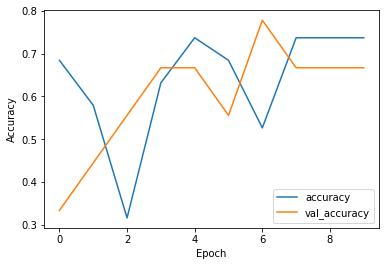

In [22]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt

# 定义地图类型
map_types = ['yes', 'no']
resize_size=500

# 数据路径
train_dir = 'data/train'
test_dir = 'data/test'

# 数据生成器及数据增强
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1.0/255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(resize_size, resize_size), 
    batch_size=5,
    class_mode='sparse',
    classes=map_types  # 指定类别
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(resize_size, resize_size),  
    batch_size=5,
    class_mode='sparse',
    classes=map_types  # 指定类别
)

# 构建CNN模型
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(resize_size, resize_size, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(len(map_types), activation='softmax')  # 输出层神经元数与类别数一致
])

# 编译模型
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 训练模型
history = model.fit(
    train_generator,
    epochs=10,
    validation_data=test_generator
)

# 评估模型
test_loss, test_acc = model.evaluate(test_generator, verbose=2)
print(f'Test accuracy: {test_acc}')

# 可视化训练结果
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.show()

In [27]:
image_paths = r"map\\"+"map_test.png"

  You can safely remove it manually.
ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\Atlas\\anaconda3\\Lib\\site-packages\\cv2\\cv2.pyd'
Consider using the `--user` option or check the permissions.




INFO: pip is looking at multiple versions of scipy to determine which version is compatible with other requirements. This could take a while.
     -------------------------------------- 60.6/60.6 kB 799.0 kB/s eta 0:00:00
   ---------------------------------------- 38.8/38.8 MB 6.5 MB/s eta 0:00:00
   ---------------------------------------- 948.0/948.0 kB 7.5 MB/s eta 0:00:00
   ---------------------------------------- 46.2/46.2 MB 4.5 MB/s eta 0:00:00
   ---------------------------------------- 1.4/1.4 MB 5.1 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.7.3
    Uninstalling scipy-1.7.3:
      Successfully uninstalled scipy-1.7.3


In [77]:
# Instance Segmentation
!pip install torch torchvision pillow

In [9]:
import torch
import torchvision
from torchvision import transforms as T
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import random

In [10]:
# 加载预训练的 Mask R-CNN 模型
model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
model.eval()

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

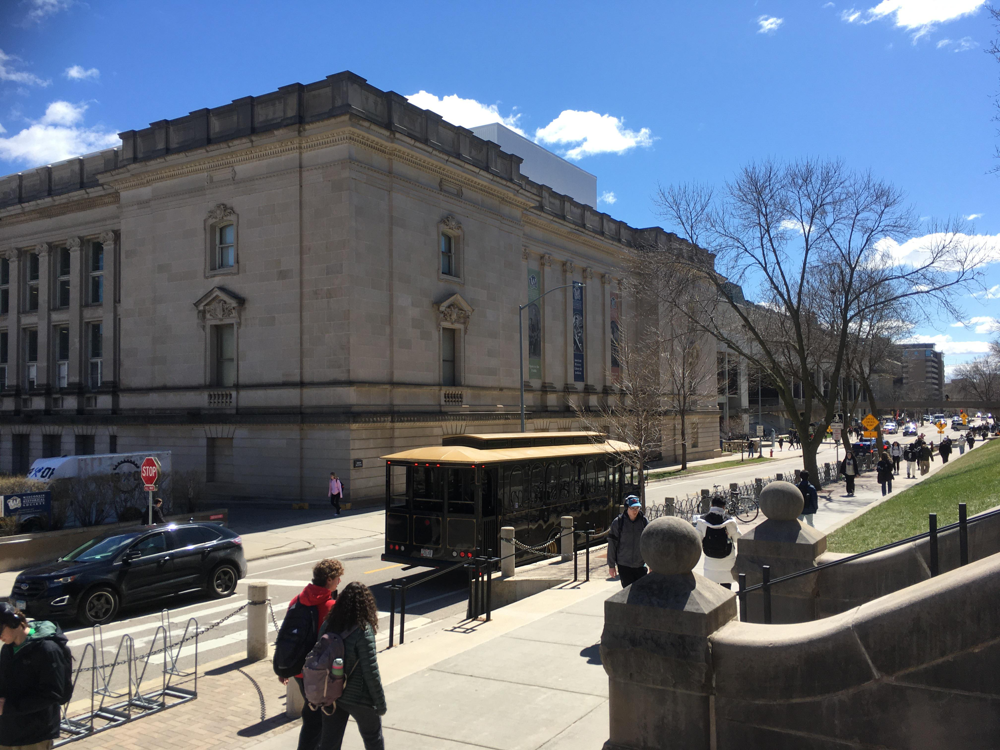

In [11]:
# 定义类别标签
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag',
    'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite',
    'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana',
    'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table',
    'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock',
    'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

# 定义图片的预处理步骤
transform = T.Compose([
    T.ToTensor()
])

# 读取和预处理图片
image_path =  r"map\\"+"madison3.jpg" # 将此路径替换为你的地图图片路径
image = Image.open(image_path).convert("RGB")
image_tensor = transform(image)
display(image)

# 将图片添加到一个批次中
image_tensor = image_tensor.unsqueeze(0)

In [13]:
# 进行实例分割
with torch.no_grad():
    prediction = model(image_tensor)

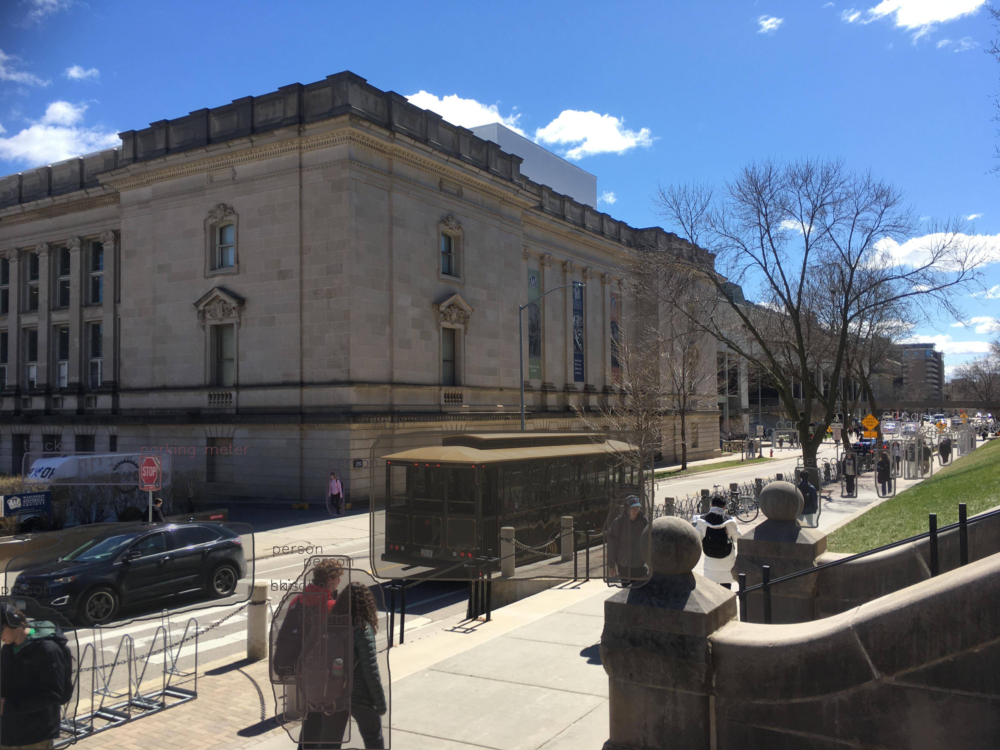

成功分割出的实例数目: 34


In [16]:
# 将 PIL 图像转换为 numpy 数组
image_np = np.array(image)

# 计数器
successful_detections = 0

# 为每个类别生成随机颜色
category_colors = {i: [random.randint(0, 255) for _ in range(3)] for i in range(len(COCO_INSTANCE_CATEGORY_NAMES))}

# 绘制分割结果
for element in range(len(prediction[0]['masks'])):
    if prediction[0]['scores'][element] > 0.3:  # 调整置信度阈值为0.3
        successful_detections += 1
        mask = prediction[0]['masks'][element, 0].mul(255).byte().cpu().numpy()
        
        # 获取类别索引并生成颜色
        category_id = prediction[0]['labels'][element].item()
        color = category_colors[category_id]
        
        # 找到掩码的轮廓
        contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        
        # 计算掩码区域的颜色均值
        masked_image = cv2.bitwise_and(image_np, image_np, mask=mask)
        mean_color = cv2.mean(masked_image, mask=mask)[:3]  # 只取前3个通道 (B, G, R)
        color=mean_color
        
        # 创建半透明掩码
        overlay = image_np.copy()
        for contour in contours:
            cv2.drawContours(overlay, [contour], -1, color, thickness=cv2.FILLED)
        image_np = cv2.addWeighted(overlay, 0.25, image_np, 0.75, 0)
        
        # 绘制轮廓
        for contour in contours:
            cv2.polylines(image_np, [contour], isClosed=True, color=color, thickness=5)
        
        # 获取类别名称并绘制标签
        x, y, w, h = cv2.boundingRect(contours[0])
        label = COCO_INSTANCE_CATEGORY_NAMES[category_id]
        cv2.putText(image_np, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 2, color, 2)

# 将 numpy 数组转换回 PIL 图像
result_image = Image.fromarray(image_np)
result_image_path = image_path[:-4] + "-output.png"
result_image.save(result_image_path)
display(result_image)

# 输出成功分割的数目
print(f"成功分割出的实例数目: {successful_detections}")